### The aim of this project is to analyze international trade data and to do the following tasks:
#### 1/ correct any spelling mistakes related to units
#### 2/ classifying the commodities using nlp algorithms to suggest the most suitable unit for future products
#### 3/ clusternig the products based on their HS code,weight, quantity, trade value, and category
#### 4/ predict the quantity based on the other facctors to detect outliers

# The first step is to explore our data and eliminate any missing values

In [3]:
import pandas as pd 
import matplotlib.pyplot as plt
import seaborn as sns
import missingno as msno
import numpy as np
import random

In [4]:
data=pd.read_csv('commodity_trade_statistics_data.csv')
data

C:\Users\utilisateur\AppData\Local\Temp\ipykernel_18456\3268719520.py:1: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  data=pd.read_csv('commodity_trade_statistics_data.csv')


,country_or_area,year,comm_code,commodity,flow,trade_usd,weight_kg,quantity_name,quantity,category
0,Afghanistan,2016,10410,"Sheep, live",Export,6088,2339.0,Number of items,51.0,01_live_animals
1,Afghanistan,2016,10420,"Goats, live",Export,3958,984.0,Number of items,53.0,01_live_animals
2,Afghanistan,2008,10210,"Bovine animals, live pure-bred breeding",Import,1026804,272.0,Number of items,3769.0,01_live_animals
3,Albania,2016,10290,"Bovine animals, live, except pure-bred breeding",Import,2414533,1114023.0,Number of items,6853.0,01_live_animals
4,Albania,2016,10392,"Swine, live except pure-bred breeding > 50 kg",Import,14265937,9484953.0,Number of items,96040.0,01_live_animals
...,...,...,...,...,...,...,...,...,...,...
8225866,Zimbabwe,2001,TOTAL,ALL COMMODITIES,Export,1206807424,NaN,No Quantity,NaN,all_commodities
8225867,Zimbabwe,2001,TOTAL,ALL COMMODITIES,Re-Export,15943977,NaN,No Quantity,NaN,all_commodities
8225868,Zimbabwe,2000,TOTAL,ALL COMMODITIES,Export,1924962432,NaN,No Quantity,NaN,all_commodities
8225869,Zimbabwe,1995,TOTAL,ALL COMMODITIES,Import,2658853376,NaN,No Quantity,NaN,all_commodities


In [5]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8225871 entries, 0 to 8225870
Data columns (total 10 columns):
 #   Column           Dtype  
---  ------           -----  
 0   country_or_area  object 
 1   year             int64  
 2   comm_code        object 
 3   commodity        object 
 4   flow             object 
 5   trade_usd        int64  
 6   weight_kg        float64
 7   quantity_name    object 
 8   quantity         float64
 9   category         object 
dtypes: float64(2), int64(2), object(6)
memory usage: 627.6+ MB


<AxesSubplot:>

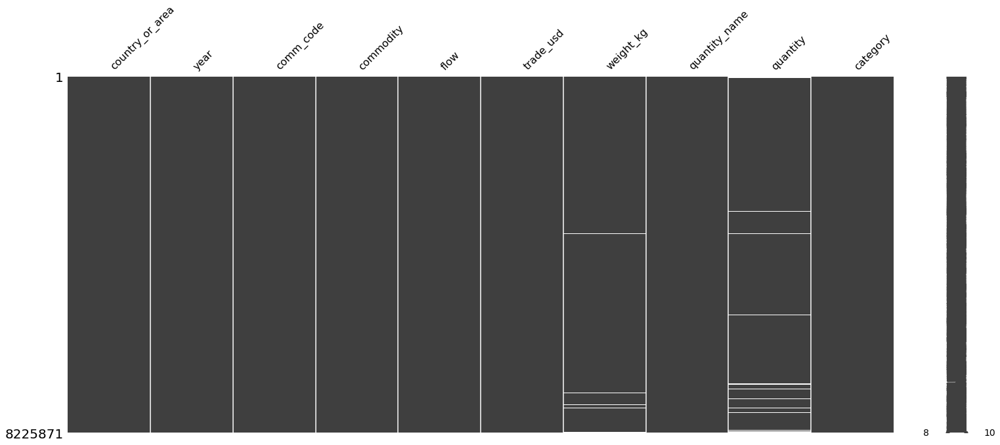

In [6]:
msno.matrix(data)

#### based on the matrix we notce that only the weight and quantity contain missing data

In [7]:
data.isna().sum()

country_or_area         0
year                    0
comm_code               0
commodity               0
flow                    0
trade_usd               0
weight_kg          128475
quantity_name           0
quantity           304857
category                0
dtype: int64

#### since the missing data represents a small part of our overall data, we can just drop the rows with missing values 

<AxesSubplot:>

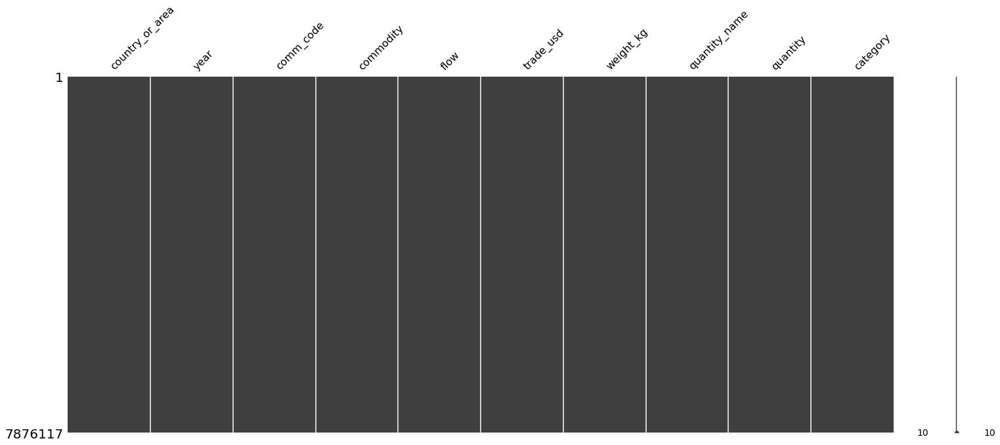

In [8]:
data.dropna(axis=0,inplace= True)
msno.matrix(data)

In [7]:
df= data

In [8]:
df['quantity_name'].unique()

array(['Number of items', 'Weight in kilograms', 'No Quantity',
       'Volume in litres', 'Length in metres', 'Area in square metres',
       'Electrical energy in thousands of kilowatt-hours',
       'Volume in cubic meters', 'Number of pairs', 'Thousands of items',
       'Weight in carats', 'Number of packages'], dtype=object)

In [9]:
df['quantity_name'].value_counts()

Weight in kilograms                                 6617814
Number of items                                      676412
No Quantity                                          200319
Volume in litres                                     142907
Area in square metres                                132088
Number of pairs                                       67086
Length in metres                                      17107
Volume in cubic meters                                16005
Weight in carats                                       3882
Thousands of items                                     1383
Number of packages                                     1039
Electrical energy in thousands of kilowatt-hours         75
Name: quantity_name, dtype: int64

## Correcting the spelling mistakes

In [43]:
#vocabs={'Weight in kilograms':['Weight in kilograms','kg','Kilogramm','kilo'],'Number of items':['Number of items','No','Numberr'],
#       'No Quantity':['No Quantity','X'],'Volume in litres':['Volume in litres','liters','L'],'Area in square metres':['Area in square metres','m2'],
#       'Number of pairs':['Number of pairs','pairr','peirs'],'Length in metres':['Length in metres','meters','m'],'Volume in cubic meters':['Volume in cubic meters','m3'],
 #      'Weight in carats':['Weight in carats'],'Number of packages':['Number of packages','paccages'],'Electrical energy in thousands of kilowatt-hours':['Electrical energy in thousands of kilowatt-hours'],
 #      'Thousands of items':['Thousands of items']}

#### We import the data file where the spelling of the units contains mistakes

In [51]:
df= pd.read_csv('correction.csv')
df

C:\Users\utilisateur\AppData\Local\Temp\ipykernel_31320\1845578934.py:1: DtypeWarning: Columns (3) have mixed types. Specify dtype option on import or set low_memory=False.
  df= pd.read_csv('correction.csv')


,Unnamed: 0,country_or_area,year,comm_code,commodity,flow,trade_usd,weight_kg,quantity_name,quantity,category
0,0,Afghanistan,2016,10410,"Sheep, live",Export,6088,2339.0,No,51.0,01_live_animals
1,1,Afghanistan,2016,10420,"Goats, live",Export,3958,984.0,No,53.0,01_live_animals
2,2,Afghanistan,2008,10210,"Bovine animals, live pure-bred breeding",Import,1026804,272.0,Number of items,3769.0,01_live_animals
3,3,Albania,2016,10290,"Bovine animals, live, except pure-bred breeding",Import,2414533,1114023.0,Number of items,6853.0,01_live_animals
4,4,Albania,2016,10392,"Swine, live except pure-bred breeding > 50 kg",Import,14265937,9484953.0,Numberr,96040.0,01_live_animals
...,...,...,...,...,...,...,...,...,...,...,...
7876112,8225123,Tunisia,1995,TOTAL,ALL COMMODITIES,Export,5474626110,0.0,No Quantity,0.0,all_commodities
7876113,8225460,United Kingdom,1998,TOTAL,ALL COMMODITIES,Import,311879512430,0.0,X,0.0,all_commodities
7876114,8225461,United Kingdom,1998,TOTAL,ALL COMMODITIES,Export,270295285433,0.0,X,0.0,all_commodities
7876115,8225462,United Kingdom,1997,TOTAL,ALL COMMODITIES,Import,305135405241,0.0,No Quantity,0.0,all_commodities


In [52]:
def split(word):
  return [(word[:i], word[i:]) for i in range(len(word) + 1)]

def delete(word):
  return [l + r[1:] for l,r in split(word) if r]

def swap(word):
  return [l + r[1] + r[0] + r[2:] for l, r in split(word) if len(r)>1]

def replace(word):
  characters = 'ABCDEFGHIJKLMNOPQRSTUVWXYZabcdefghijklmnopqrstuvwxyz1234567890£µ%§/.?<*$ù!:;,=)+&é-è_çà^>'
  return [l + c + r[1:] for l, r in split(word) if r for c in characters]

def insert(word):
  characters = 'ABCDEFGHIJKLMNOPQRSTUVWXYZabcdefghijklmnopqrstuvwxyz1234567890£µ%§/.?<*$ù!:;,=)+&é-è_çà^>'
  return [l + c + r for l, r in split(word) for c in characters]

def edit1(word):
  return set(delete(word) + swap(word) + replace(word) + insert(word))

def edit2(word):
  return set(e2 for e1 in edit1(word) for e2 in edit1(e1))

In [53]:
def find_key(word):
    for key in vocabs.keys():
         if word in vocabs[key]:
             return key
    return

In [54]:
def correct_spelling(word):
    if find_key(word)!=None:
        return find_key(word)
    else:
        suggestions = set().union(edit1(word)).union(edit2(word)) or  [word]
        best_guesses=[]
        for key in voca.keys():
            for w in suggestions:
                if w in voca[key]:
                    
                    best_guesses.append(w)
        voca[key].append(word)
        return key

In [55]:
def save_dict_to_file(dic,name):
    f = open(name+'.txt','w')
    f.write(str(dic))
    f.close()

def load_dict_from_file(file):
    f = open(file,'r')
    data=f.read()
    f.close()
    return eval(data)

In [56]:
save_dict_to_file(vocabs,'units')
voc = load_dict_from_file('units.txt')
voc

{'Weight in kilograms': ['Weight in kilograms', 'kg', 'Kilogramm', 'kilo'],
 'Number of items': ['Number of items', 'No', 'Numberr'],
 'No Quantity': ['No Quantity', 'X'],
 'Volume in litres': ['Volume in litres', 'liters', 'L'],
 'Area in square metres': ['Area in square metres', 'm2'],
 'Number of pairs': ['Number of pairs', 'pairr', 'peirs'],
 'Length in metres': ['Length in metres', 'meters', 'm'],
 'Volume in cubic meters': ['Volume in cubic meters', 'm3'],
 'Weight in carats': ['Weight in carats'],
 'Number of packages': ['Number of packages', 'paccages'],
 'Electrical energy in thousands of kilowatt-hours': ['Electrical energy in thousands of kilowatt-hours'],
 'Thousands of items': ['Thousands of items']}

In [57]:
dats=str(input('select your data file: '))
df=pd.read_csv(dats)
col=str(input('select the column that needs correction: '))
dictio=str(input('select your dictionary file: '))
voca = load_dict_from_file(dictio)
corrected = 'corrected'+col
df[corrected]= df[col].apply(correct_spelling)
save_dict_to_file(voca,'US_UNITS')

select your data file: correction.csv


C:\Users\utilisateur\AppData\Local\Temp\ipykernel_31320\2393710341.py:2: DtypeWarning: Columns (3) have mixed types. Specify dtype option on import or set low_memory=False.
  df=pd.read_csv(dats)


select the column that needs correction: quantity_name
select your dictionary file: units.txt


In [61]:
df

,Unnamed: 0,country_or_area,year,comm_code,commodity,flow,trade_usd,weight_kg,quantity_name,quantity,category,correctedquantity_name
0,0,Afghanistan,2016,10410,"Sheep, live",Export,6088,2339.0,No,51.0,01_live_animals,Number of items
1,1,Afghanistan,2016,10420,"Goats, live",Export,3958,984.0,No,53.0,01_live_animals,Number of items
2,2,Afghanistan,2008,10210,"Bovine animals, live pure-bred breeding",Import,1026804,272.0,Number of items,3769.0,01_live_animals,Number of items
3,3,Albania,2016,10290,"Bovine animals, live, except pure-bred breeding",Import,2414533,1114023.0,Number of items,6853.0,01_live_animals,Number of items
4,4,Albania,2016,10392,"Swine, live except pure-bred breeding > 50 kg",Import,14265937,9484953.0,Numberr,96040.0,01_live_animals,Number of items
...,...,...,...,...,...,...,...,...,...,...,...,...
7876112,8225123,Tunisia,1995,TOTAL,ALL COMMODITIES,Export,5474626110,0.0,No Quantity,0.0,all_commodities,No Quantity
7876113,8225460,United Kingdom,1998,TOTAL,ALL COMMODITIES,Import,311879512430,0.0,X,0.0,all_commodities,No Quantity
7876114,8225461,United Kingdom,1998,TOTAL,ALL COMMODITIES,Export,270295285433,0.0,X,0.0,all_commodities,No Quantity
7876115,8225462,United Kingdom,1997,TOTAL,ALL COMMODITIES,Import,305135405241,0.0,No Quantity,0.0,all_commodities,No Quantity


#### after completing the spelling correction for our data we move onto the next step which is the unit classification in which we can suggest the most suitable unit for each commodity 

# Classification
#### For our classification problem we'll use 3 approaches 
#### 1/ we'll take a random sample of data to which we'll apply our algorithms to (multiclass problem)
#### 2/ since the weight in kilogram unit is the most dominant we'll use a binary classification approach
#### 3/ we'll take a balanced data sample and apply our algorithms to it

## 1/ random sample

In [70]:
data=pd.read_csv('commodity_trade_statistics_data.csv')
data.dropna(inplace= True)
data['quantity_name'].value_counts()

C:\Users\utilisateur\AppData\Local\Temp\ipykernel_31320\2671920036.py:1: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  data=pd.read_csv('commodity_trade_statistics_data.csv')


Weight in kilograms                                 6617814
Number of items                                      676412
No Quantity                                          200319
Volume in litres                                     142907
Area in square metres                                132088
Number of pairs                                       67086
Length in metres                                      17107
Volume in cubic meters                                16005
Weight in carats                                       3882
Thousands of items                                     1383
Number of packages                                     1039
Electrical energy in thousands of kilowatt-hours         75
Name: quantity_name, dtype: int64

In [65]:
df['correctedquantity_name'].value_counts()

Weight in kilograms                                 6617814
Number of items                                      676412
No Quantity                                          200319
Volume in litres                                     142907
Area in square metres                                132088
Number of pairs                                       67086
Length in metres                                      17107
Volume in cubic meters                                16005
Weight in carats                                       3882
Thousands of items                                     1383
Number of packages                                     1039
Electrical energy in thousands of kilowatt-hours         75
Name: correctedquantity_name, dtype: int64

In [75]:
df=df[['commodity','correctedquantity_name','category']]
df1=df[['commodity','correctedquantity_name','category']]
#df2=df.loc[data['quantity_name'] == 'Weight in kilograms'].sample(n=7000)
#df3=df.loc[data['quantity_name'] == 'Number of items'].sample(n=8000)
#df4=df.loc[data['quantity_name'] == 'No Quantity'].sample(n=7000)
#df5=df.loc[data['quantity_name'] == 'Volume in litres'].sample(n=9000)
#df6=df.loc[data['quantity_name'] == 'Area in square metres'].sample(n=9000)
#df7=df.loc[data['quantity_name'] == 'Number of pairs'].sample(n=9000)
df8=df.loc[df['correctedquantity_name'] == 'Length in metres'].sample(n=5000)
df9=df.loc[df['correctedquantity_name'] == 'Volume in cubic meters'].sample(n=2000)
##df10=df.loc[data['quantity_name'] == 'Weight in carats']
#df11=df.loc[data['quantity_name'] == 'Thousands of items']
#df12=df.loc[data['quantity_name'] == 'Number of packages']
#df13=df.loc[data['quantity_name'] == 'Electrical energy in thousands of kilowatt-hours']


In [76]:
#since our dataset contains all transaction flows from different countries many of the products will be repeated that's why we try to reduce the size of our data by droping the duplicated rows
df.drop_duplicates(inplace=True)
df=df.append(df1.sample(n=310000))
#df=df.append(df13)
#df=df.append(df2)
#df=df.append(df3)
##df=df.append(df4)
#df=df.append(df5)
#df=df.append(df6)
#df=df.append(df7)
df=df.append(df8)
df=df.append(df9)
##df=df.append(df10)
#df=df.append(df11)
#df=df.append(df12)df['commodity'][16]

C:\Users\utilisateur\AppData\Local\Temp\ipykernel_31320\2616876263.py:3: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(df1.sample(n=310000))
C:\Users\utilisateur\AppData\Local\Temp\ipykernel_31320\2616876263.py:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(df8)
C:\Users\utilisateur\AppData\Local\Temp\ipykernel_31320\2616876263.py:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df=df.append(df9)


In [77]:
df['correctedquantity_name'].value_counts()

Weight in kilograms                                 265419
Number of items                                      28707
No Quantity                                          12170
Length in metres                                      6117
Volume in litres                                      5984
Area in square metres                                 5741
Number of pairs                                       2702
Volume in cubic meters                                2625
Weight in carats                                       167
Thousands of items                                      60
Number of packages                                      53
Electrical energy in thousands of kilowatt-hours         3
Name: correctedquantity_name, dtype: int64

In [79]:
df=df.loc[df['correctedquantity_name'] != 'Electrical energy in thousands of kilowatt-hours']

In [80]:
df.isnull().sum()  

commodity                 0
correctedquantity_name    0
category                  0
dtype: int64

In [82]:
df['correctedquantity_name'].unique()

array(['Number of items', 'Weight in kilograms', 'No Quantity',
       'Volume in litres', 'Length in metres', 'Area in square metres',
       'Volume in cubic meters', 'Number of pairs', 'Thousands of items',
       'Weight in carats', 'Number of packages'], dtype=object)

<AxesSubplot:>

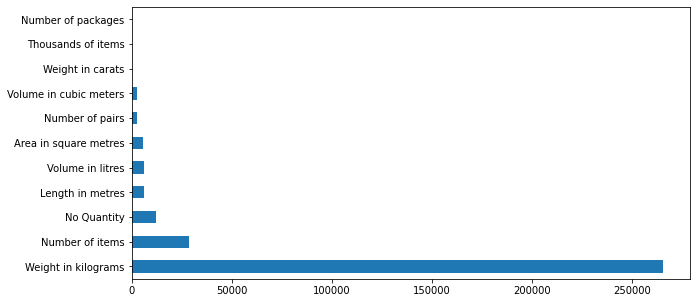

In [83]:
fig,ax=plt.subplots(figsize=(10,5))
df['correctedquantity_name'].value_counts().plot(kind='barh')

In [84]:
df.reset_index(inplace=True)

In [85]:
df['commodity'][16]

'Bovine animals, live pure-bred breeding'

In [16]:
import string
import re
from nltk.corpus import stopwords
from nltk.stem import PorterStemmer
from nltk.tokenize import sent_tokenize, word_tokenize
import nltk
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfTransformer
from sklearn.model_selection import train_test_split
from sklearn.pipeline import Pipeline
nltk.download('averaged_perceptron_tagger')
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import MultinomialNB
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import LinearSVC
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.model_selection import GridSearchCV

from sklearn.metrics import accuracy_score, classification_report

[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     C:\Users\utilisateur\AppData\Roaming\nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!


In [11]:
stop = stopwords.words('english')
print(stop[::10])

porter = PorterStemmer()

['i', "you've", 'himself', 'they', 'that', 'been', 'a', 'while', 'through', 'in', 'here', 'few', 'own', 'just', 're', 'doesn', 'ma', "shouldn't"]


In [12]:
def remove_punctuation(description):
    """The function to remove punctuation"""
    table = str.maketrans('', '', string.punctuation)
    return description.translate(table)

def remove_stopwords(text):
    """The function to removing stopwords"""
    text = [word.lower() for word in text.split() if word.lower() not in stop]
    return " ".join(text)

def stemmer(stem_text):
    """The function to apply stemming"""
    stem_text = [porter.stem(word) for word in stem_text.split()]
    return " ".join(stem_text)

In [89]:
df['commodity'] = df['commodity'].apply(remove_punctuation)
df['commodity'] = df['commodity'].apply(remove_stopwords)
df['commodity'] = df['commodity'].apply(stemmer)

C:\Users\utilisateur\AppData\Local\Temp\ipykernel_31320\749261159.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['commodity'] = df['commodity'].apply(remove_punctuation)
C:\Users\utilisateur\AppData\Local\Temp\ipykernel_31320\749261159.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['commodity'] = df['commodity'].apply(remove_stopwords)
C:\Users\utilisateur\AppData\Local\Temp\ipykernel_31320\749261159.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

In [90]:
df.head()

,index,commodity,correctedquantity_name,category
0,0,sheep live,Number of items,01_live_animals
1,1,goat live,Number of items,01_live_animals
2,2,bovin anim live purebr breed,Number of items,01_live_animals
3,3,bovin anim live except purebr breed,Number of items,01_live_animals
4,4,swine live except purebr breed 50 kg,Number of items,01_live_animals


In [91]:
vectorizer = CountVectorizer()
vectorizer.fit(df['commodity'])
vector = vectorizer.transform(df['commodity'])
print(vector.shape)
print(vector.toarray())

(329745, 4075)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]


In [92]:
# extract the tfid representation matrix of the text data
tfidf_converter = TfidfTransformer()
X_tfidf = tfidf_converter.fit_transform(vector).toarray()
X_tfidf

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])

In [94]:
X = df['commodity']
y = df['correctedquantity_name']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state = 123)
X_train.shape, X_test.shape, y_train.shape, y_test.shape

((230821,), (98924,), (230821,), (98924,))

### SVC

In [95]:
svc = Pipeline([('vect', CountVectorizer(min_df=5, ngram_range=(1,2))),
               ('tfidf', TfidfTransformer()),
               ('model',LinearSVC()),
               ])

svc.fit(X_train, y_train)

ytest = np.array(y_test)
y_pred = svc.predict(X_test)

print('accuracy %s' % accuracy_score(y_pred, ytest))
print(classification_report(ytest,y_pred))

accuracy 0.9010351380858033
                        precision    recall  f1-score   support

 Area in square metres       0.72      0.80      0.76      1715
      Length in metres       0.88      0.56      0.69      1838
           No Quantity       0.54      0.06      0.11      3664
       Number of items       0.71      0.88      0.78      8583
    Number of packages       0.55      1.00      0.71        16
       Number of pairs       0.73      0.96      0.83       786
    Thousands of items       0.73      1.00      0.85        22
Volume in cubic meters       0.88      1.00      0.94       786
      Volume in litres       0.95      0.63      0.76      1828
      Weight in carats       0.48      0.57      0.52        47
   Weight in kilograms       0.93      0.96      0.95     79639

              accuracy                           0.90     98924
             macro avg       0.74      0.77      0.72     98924
          weighted avg       0.89      0.90      0.89     98924



### Random Forest

In [96]:
rf = Pipeline([('vect', CountVectorizer(min_df=5, ngram_range=(1,2))),
               ('tfidf', TfidfTransformer()),
               ('rf', RandomForestClassifier(n_estimators=50)),
               ])

rf.fit(X_train, y_train)

ytest = np.array(y_test)
preds = rf.predict(X_test)

print('accuracy %s' % accuracy_score(preds, y_test))
print(classification_report(ytest, preds))

accuracy 0.900903724071004
                        precision    recall  f1-score   support

 Area in square metres       0.72      0.80      0.76      1715
      Length in metres       0.87      0.56      0.68      1838
           No Quantity       0.54      0.07      0.12      3664
       Number of items       0.71      0.88      0.78      8583
    Number of packages       0.55      1.00      0.71        16
       Number of pairs       0.73      0.96      0.83       786
    Thousands of items       0.73      1.00      0.85        22
Volume in cubic meters       0.88      1.00      0.94       786
      Volume in litres       0.95      0.63      0.76      1828
      Weight in carats       0.48      0.57      0.52        47
   Weight in kilograms       0.93      0.96      0.95     79639

              accuracy                           0.90     98924
             macro avg       0.74      0.77      0.72     98924
          weighted avg       0.89      0.90      0.89     98924



### Naive Bayes

In [97]:
nbc = Pipeline([('vect', CountVectorizer(min_df=3, ngram_range=(1,2))),
               ('tfidf', TfidfTransformer()),
               ('model',MultinomialNB()),
               ])

nbc.fit(X_train, y_train)

ytest = np.array(y_test)
pred_y = nbc.predict(X_test)


print('accuracy %s' % accuracy_score(pred_y, y_test))
print(classification_report(ytest, pred_y))

accuracy 0.8741357001334358


C:\Users\utilisateur\.conda\envs\python\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\utilisateur\.conda\envs\python\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


                        precision    recall  f1-score   support

 Area in square metres       0.69      0.78      0.73      1715
      Length in metres       0.46      0.75      0.57      1838
           No Quantity       0.36      0.19      0.25      3664
       Number of items       0.69      0.87      0.77      8583
    Number of packages       0.00      0.00      0.00        16
       Number of pairs       0.69      0.95      0.80       786
    Thousands of items       0.00      0.00      0.00        22
Volume in cubic meters       0.85      0.96      0.90       786
      Volume in litres       0.59      0.82      0.69      1828
      Weight in carats       0.00      0.00      0.00        47
   Weight in kilograms       0.95      0.91      0.93     79639

              accuracy                           0.87     98924
             macro avg       0.48      0.57      0.51     98924
          weighted avg       0.88      0.87      0.87     98924



C:\Users\utilisateur\.conda\envs\python\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


### Neural Networks

In [15]:
from sklearn.metrics import confusion_matrix
from sklearn.preprocessing import LabelEncoder
import tensorflow as tf
from tensorflow import keras
from keras.models import Sequential
from tensorflow.python.keras.layers import Dense, Flatten, Activation, Dropout, GlobalMaxPool1D, Conv1D
from tensorflow.python.keras.layers.embeddings import Embedding
from keras.preprocessing import text, sequence
from keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from keras import utils

In [99]:
sentences = df['commodity']
y = df['correctedquantity_name']
sentences_train, sentences_test, train_y, test_y = train_test_split(sentences, y, test_size=0.3, random_state=42)
sentences_train,sentences_val,train_y, val_y = train_test_split(sentences_train, train_y,test_size=0.25, random_state= 42) 


In [100]:
tokenize = Tokenizer(num_words=1000)
tokenize.fit_on_texts(sentences_train)

X_train = tokenize.texts_to_sequences(sentences_train)
X_test = tokenize.texts_to_sequences(sentences_test)
X_val = tokenize.texts_to_sequences(sentences_val)
vocab_size = len(tokenize.word_index) + 1  

print(sentences_train[3])
print(X_train[3])

bovin anim live except purebr breed
[336, 163, 11, 14, 27, 8, 477]


In [101]:
maxlen = 20

X_train = pad_sequences(X_train, padding='post', maxlen=maxlen)
X_test = pad_sequences(X_test, padding='post', maxlen=maxlen)
X_val = pad_sequences(X_val, padding='post', maxlen=maxlen)
print(X_train[0, :])

[ 21 149 227 392 598 848   0   0   0   0   0   0   0   0   0   0   0   0
   0   0]


In [112]:
encoder = LabelEncoder()
encoder.fit(train_y)
y_train = encoder.transform(train_y)
y_test = encoder.transform(test_y)
y_val = encoder.transform(val_y)
num_classes = np.max(y_train) + 1
y_train = utils.to_categorical(y_train, num_classes)
y_test = utils.to_categorical(y_test, num_classes)
y_val = utils.to_categorical(y_val, num_classes)

#### Architecture 1

In [113]:
embedding_dim = 16

model = Sequential()
model.add(Embedding(input_dim=vocab_size, output_dim=embedding_dim, input_length=maxlen))
model.add(Flatten())
model.add(Dense(16, activation='relu'))
model.add(Dense(11, activation='softmax'))

model.compile(optimizer='adam',
              loss='categorical_crossentropy',
              metrics=['accuracy'])
model.build(X_train.shape) 
model.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 module_wrapper_4 (ModuleWra  (173115, 20, 16)         65296     
 pper)                                                           
                                                                 
 module_wrapper_5 (ModuleWra  (173115, 320)            0         
 pper)                                                           
                                                                 
 module_wrapper_6 (ModuleWra  (173115, 16)             5136      
 pper)                                                           
                                                                 
 module_wrapper_7 (ModuleWra  (173115, 11)             187       
 pper)                                                           
                                                                 
Total params: 70,619
Trainable params: 70,619
Non-trai

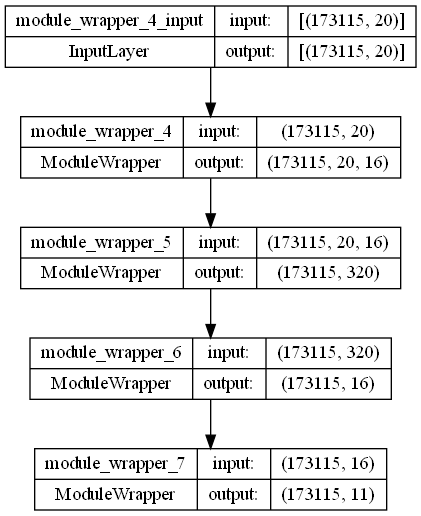

In [114]:
from keras.utils import plot_model
plot_model(model, to_file='model_1.png', show_shapes=True, show_layer_names=True)


In [115]:
history = model.fit(X_train, y_train,
                    batch_size=32,
                    epochs=15,
                    validation_data=(X_val, y_val))

Epoch 1/15
5410/5410 [==============================] - 7s 1ms/step - loss: 0.4520 - accuracy: 0.8714 - val_loss: 0.3826 - val_accuracy: 0.8842
Epoch 2/15
5410/5410 [==============================] - 6s 1ms/step - loss: 0.3658 - accuracy: 0.8873 - val_loss: 0.3660 - val_accuracy: 0.8857
Epoch 3/15
5410/5410 [==============================] - 6s 1ms/step - loss: 0.3558 - accuracy: 0.8893 - val_loss: 0.3623 - val_accuracy: 0.8879
Epoch 4/15
5410/5410 [==============================] - 6s 1ms/step - loss: 0.3519 - accuracy: 0.8899 - val_loss: 0.3621 - val_accuracy: 0.8855
Epoch 5/15
5410/5410 [==============================] - 7s 1ms/step - loss: 0.3486 - accuracy: 0.8905 - val_loss: 0.3607 - val_accuracy: 0.8882
Epoch 6/15
5410/5410 [==============================] - 8s 2ms/step - loss: 0.3462 - accuracy: 0.8912 - val_loss: 0.3586 - val_accuracy: 0.8887
Epoch 7/15
5410/5410 [==============================] - 7s 1ms/step - loss: 0.3447 - accuracy: 0.8919 - val_loss: 0.3589 - val_accuracy:

In [116]:
loss, accuracy = model.evaluate(X_train, y_train, verbose=False)
print("Training Accuracy: {:.4f}".format(accuracy))
loss, accuracy = model.evaluate(X_test, y_test, verbose=False)
print("Testing Accuracy:  {:.4f}".format(accuracy))


Training Accuracy: 0.8946
Testing Accuracy:  0.8921


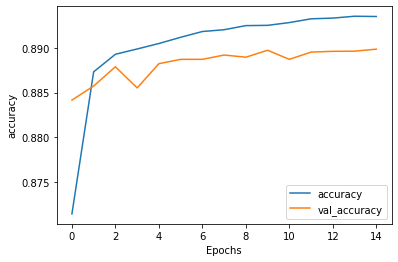

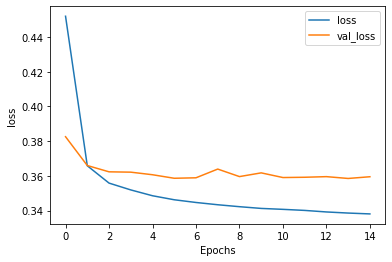

In [117]:
def plot_graphs(history, string):
    plt.plot(history.history[string])
    plt.plot(history.history['val_'+string])
    plt.xlabel("Epochs")
    plt.ylabel(string)
    plt.legend([string, 'val_'+string])
    plt.show()

plot_graphs(history, "accuracy")
plot_graphs(history, "loss")


#### Architecture 2

In [120]:
embedding_dim = 50

model3 = Sequential()
model3.add(Embedding(input_dim=vocab_size, output_dim=embedding_dim, input_length=maxlen))
model3.add(GlobalMaxPool1D())
model3.add(Dense(16, activation='relu'))
model3.add(Dense(11, activation='softmax'))

model3.compile(optimizer='adam',
               loss='categorical_crossentropy',
               metrics=['accuracy'])
model3.build(X_train.shape) 
model3.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 module_wrapper_12 (ModuleWr  (173115, 20, 50)         204050    
 apper)                                                          
                                                                 
 module_wrapper_13 (ModuleWr  (173115, 50)             0         
 apper)                                                          
                                                                 
 module_wrapper_14 (ModuleWr  (173115, 16)             816       
 apper)                                                          
                                                                 
 module_wrapper_15 (ModuleWr  (173115, 11)             187       
 apper)                                                          
                                                                 
Total params: 205,053
Trainable params: 205,053
Non-tr

In [121]:
history_3 = model3.fit(X_train, y_train,
                    batch_size=32,
                    epochs=15,
                    validation_data=(X_val, y_val))

Epoch 1/15
5410/5410 [==============================] - 9s 2ms/step - loss: 0.4906 - accuracy: 0.8587 - val_loss: 0.3799 - val_accuracy: 0.8847
Epoch 2/15
5410/5410 [==============================] - 8s 2ms/step - loss: 0.3652 - accuracy: 0.8875 - val_loss: 0.3662 - val_accuracy: 0.8859
Epoch 3/15
5410/5410 [==============================] - 8s 1ms/step - loss: 0.3547 - accuracy: 0.8896 - val_loss: 0.3624 - val_accuracy: 0.8870
Epoch 4/15
5410/5410 [==============================] - 9s 2ms/step - loss: 0.3502 - accuracy: 0.8909 - val_loss: 0.3590 - val_accuracy: 0.8889
Epoch 5/15
5410/5410 [==============================] - 10s 2ms/step - loss: 0.3475 - accuracy: 0.8918 - val_loss: 0.3606 - val_accuracy: 0.8895
Epoch 6/15
5410/5410 [==============================] - 10s 2ms/step - loss: 0.3457 - accuracy: 0.8926 - val_loss: 0.3597 - val_accuracy: 0.8879
Epoch 7/15
5410/5410 [==============================] - 8s 2ms/step - loss: 0.3443 - accuracy: 0.8928 - val_loss: 0.3575 - val_accurac

In [122]:
loss3, accuracy3 = model3.evaluate(X_train, y_train, verbose=False)
print("Training Accuracy: {:.4f}".format(accuracy))
loss, accuracy = model3.evaluate(X_test, y_test, verbose=False)
print("Testing Accuracy:  {:.4f}".format(accuracy))

Training Accuracy: 0.8921
Testing Accuracy:  0.8924


#### Convolutional Neural Network(CNN)

In [123]:
embedding_dim = 50

model4 = Sequential()
model4.add(Embedding(input_dim=vocab_size, output_dim=embedding_dim, input_length=maxlen))
model4.add(Conv1D(256, 5, activation='relu'))
model4.add(GlobalMaxPool1D())
model4.add(Dense(16, activation='relu'))
model4.add(Dense(11, activation='softmax'))

model4.compile(optimizer='adam',
               loss='categorical_crossentropy',
               metrics=['accuracy'])
model4.build(X_train.shape) 
model4.summary()

Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 module_wrapper_16 (ModuleWr  (173115, 20, 50)         204050    
 apper)                                                          
                                                                 
 module_wrapper_17 (ModuleWr  (173115, 16, 256)        64256     
 apper)                                                          
                                                                 
 module_wrapper_18 (ModuleWr  (173115, 256)            0         
 apper)                                                          
                                                                 
 module_wrapper_19 (ModuleWr  (173115, 16)             4112      
 apper)                                                          
                                                                 
 module_wrapper_20 (ModuleWr  (173115, 11)            

In [124]:
history_4 = model4.fit(X_train, y_train,
                    batch_size=32,
                    epochs=15,
                    validation_data=(X_val, y_val))

Epoch 1/15
5410/5410 [==============================] - 19s 3ms/step - loss: 0.4184 - accuracy: 0.8782 - val_loss: 0.3797 - val_accuracy: 0.8819
Epoch 2/15
5410/5410 [==============================] - 19s 3ms/step - loss: 0.3580 - accuracy: 0.8901 - val_loss: 0.3593 - val_accuracy: 0.8885
Epoch 3/15
5410/5410 [==============================] - 19s 3ms/step - loss: 0.3510 - accuracy: 0.8915 - val_loss: 0.3609 - val_accuracy: 0.8891
Epoch 4/15
5410/5410 [==============================] - 19s 3ms/step - loss: 0.3476 - accuracy: 0.8923 - val_loss: 0.3597 - val_accuracy: 0.8889
Epoch 5/15
5410/5410 [==============================] - 20s 4ms/step - loss: 0.3448 - accuracy: 0.8930 - val_loss: 0.3559 - val_accuracy: 0.8905
Epoch 6/15
5410/5410 [==============================] - 20s 4ms/step - loss: 0.3433 - accuracy: 0.8931 - val_loss: 0.3620 - val_accuracy: 0.8893
Epoch 7/15
5410/5410 [==============================] - 20s 4ms/step - loss: 0.3419 - accuracy: 0.8935 - val_loss: 0.3567 - val_ac

In [125]:
loss4, accuracy4 = model4.evaluate(X_train, y_train, verbose=False)
print("Training Accuracy: {:.4f}".format(accuracy))
loss, accuracy = model4.evaluate(X_test, y_test, verbose=False)
print("Testing Accuracy:  {:.4f}".format(accuracy))

Training Accuracy: 0.8924
Testing Accuracy:  0.8930


## 2/ binary classification

In [126]:
df

,index,commodity,correctedquantity_name,category
0,0,sheep live,Number of items,01_live_animals
1,1,goat live,Number of items,01_live_animals
2,2,bovin anim live purebr breed,Number of items,01_live_animals
3,3,bovin anim live except purebr breed,Number of items,01_live_animals
4,4,swine live except purebr breed 50 kg,Number of items,01_live_animals
...,...,...,...,...
329740,3716827,panel 1 outer pli nonconifer wood ne,Volume in cubic meters,44_wood_and_articles_of_wood_wood_charcoal
329741,3712242,pole treat paint preserv,Volume in cubic meters,44_wood_and_articles_of_wood_wood_charcoal
329742,2312683,oxygen,Volume in cubic meters,28_inorganic_chemicals_precious_metal_compound...
329743,3753217,lumber oak quercu spp,Volume in cubic meters,44_wood_and_articles_of_wood_wood_charcoal


In [135]:
df.loc[~df['correctedquantity_name'].isin(['Weight in kilograms']),'correctedquantity_name'] = 'other units'

In [137]:
df['correctedquantity_name'].unique()

array(['other units', 'Weight in kilograms'], dtype=object)

In [139]:
df['correctedquantity_name'].value_counts()

Weight in kilograms    265419
other units             64326
Name: correctedquantity_name, dtype: int64

In [140]:
df_bin=df[['commodity','correctedquantity_name','category']]

In [141]:
df_bin

,commodity,correctedquantity_name,category
0,sheep live,other units,01_live_animals
1,goat live,other units,01_live_animals
2,bovin anim live purebr breed,other units,01_live_animals
3,bovin anim live except purebr breed,other units,01_live_animals
4,swine live except purebr breed 50 kg,other units,01_live_animals
...,...,...,...
329740,panel 1 outer pli nonconifer wood ne,other units,44_wood_and_articles_of_wood_wood_charcoal
329741,pole treat paint preserv,other units,44_wood_and_articles_of_wood_wood_charcoal
329742,oxygen,other units,28_inorganic_chemicals_precious_metal_compound...
329743,lumber oak quercu spp,other units,44_wood_and_articles_of_wood_wood_charcoal


In [144]:
vectorizer = CountVectorizer()
vectorizer.fit(df_bin['commodity'])
vector = vectorizer.transform(df_bin['commodity'])
print(vector.shape)
print(vector.toarray())

(329745, 4075)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]


In [145]:
# extract the tfid representation matrix of the text data
tfidf_converter = TfidfTransformer()
X_tfidf = tfidf_converter.fit_transform(vector).toarray()
X_tfidf

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])

In [146]:
X = df['commodity']
y = df['correctedquantity_name']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state = 123)
X_train.shape, X_test.shape, y_train.shape, y_test.shape

((230821,), (98924,), (230821,), (98924,))

### SVC

In [148]:
svc = Pipeline([('vect', CountVectorizer(min_df=5, ngram_range=(1,2))),
               ('tfidf', TfidfTransformer()),
               ('model',LinearSVC()),
               ])

svc.fit(X_train, y_train)

ytest = np.array(y_test)
y_pred = svc.predict(X_test)

print('accuracy %s' % accuracy_score(y_pred, ytest))
print(classification_report(ytest,y_pred))

accuracy 0.9115381504993733
                     precision    recall  f1-score   support

Weight in kilograms       0.94      0.96      0.95     79639
        other units       0.80      0.73      0.76     19285

           accuracy                           0.91     98924
          macro avg       0.87      0.84      0.85     98924
       weighted avg       0.91      0.91      0.91     98924



### Random Forest

In [149]:
rf = Pipeline([('vect', CountVectorizer(min_df=5, ngram_range=(1,2))),
               ('tfidf', TfidfTransformer()),
               ('rf', RandomForestClassifier(n_estimators=50)),
               ])

rf.fit(X_train, y_train)

ytest = np.array(y_test)
preds = rf.predict(X_test)

print('accuracy %s' % accuracy_score(preds, y_test))
print(classification_report(ytest, preds))

accuracy 0.9113865189438357
                     precision    recall  f1-score   support

Weight in kilograms       0.94      0.96      0.95     79639
        other units       0.80      0.73      0.76     19285

           accuracy                           0.91     98924
          macro avg       0.87      0.84      0.85     98924
       weighted avg       0.91      0.91      0.91     98924



### Naive Bayes

In [150]:
nbc = Pipeline([('vect', CountVectorizer(min_df=3, ngram_range=(1,2))),
               ('tfidf', TfidfTransformer()),
               ('model',MultinomialNB()),
               ])

nbc.fit(X_train, y_train)

ytest = np.array(y_test)
pred_y = nbc.predict(X_test)


print('accuracy %s' % accuracy_score(pred_y, y_test))
print(classification_report(ytest, pred_y))

accuracy 0.9040980955076624
                     precision    recall  f1-score   support

Weight in kilograms       0.94      0.94      0.94     79639
        other units       0.76      0.74      0.75     19285

           accuracy                           0.90     98924
          macro avg       0.85      0.84      0.85     98924
       weighted avg       0.90      0.90      0.90     98924



### Neural Network

In [151]:
sentences = df_bin['commodity']
y = df_bin['correctedquantity_name']
sentences_train, sentences_test, train_y, test_y = train_test_split(sentences, y, test_size=0.3, random_state=42)
sentences_train,sentences_val,train_y, val_y = train_test_split(sentences_train, train_y,test_size=0.25, random_state= 42)

In [152]:
tokenize = Tokenizer(num_words=1000)
tokenize.fit_on_texts(sentences_train)

X_train = tokenize.texts_to_sequences(sentences_train)
X_test = tokenize.texts_to_sequences(sentences_test)
X_val = tokenize.texts_to_sequences(sentences_val)
vocab_size = len(tokenize.word_index) + 1  

print(sentences_train[3])
print(X_train[3])

bovin anim live except purebr breed
[336, 163, 11, 14, 27, 8, 477]


In [153]:
maxlen = 20

X_train = pad_sequences(X_train, padding='post', maxlen=maxlen)
X_test = pad_sequences(X_test, padding='post', maxlen=maxlen)
X_val = pad_sequences(X_val, padding='post', maxlen=maxlen)
print(X_train[0, :])

[ 21 149 227 392 598 848   0   0   0   0   0   0   0   0   0   0   0   0
   0   0]


In [154]:
encoder = LabelEncoder()
encoder.fit(train_y)
y_train = encoder.transform(train_y)
y_test = encoder.transform(test_y)
y_val = encoder.transform(val_y)
num_classes = np.max(y_train) + 1
y_train = utils.to_categorical(y_train, num_classes)
y_test = utils.to_categorical(y_test, num_classes)
y_val = utils.to_categorical(y_val, num_classes)

#### Architecture 1

In [156]:
embedding_dim = 16

model = Sequential()
model.add(Embedding(input_dim=vocab_size, output_dim=embedding_dim, input_length=maxlen))
model.add(Flatten())
model.add(Dense(16, activation='relu'))
model.add(Dense(2, activation='sigmoid'))

model.compile(optimizer='adam',
              loss='binary_crossentropy',
              metrics=['accuracy'])
model.build(X_train.shape) 
model.summary()

Model: "sequential_6"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 module_wrapper_25 (ModuleWr  (173115, 20, 16)         65296     
 apper)                                                          
                                                                 
 module_wrapper_26 (ModuleWr  (173115, 320)            0         
 apper)                                                          
                                                                 
 module_wrapper_27 (ModuleWr  (173115, 16)             5136      
 apper)                                                          
                                                                 
 module_wrapper_28 (ModuleWr  (173115, 2)              34        
 apper)                                                          
                                                                 
Total params: 70,466
Trainable params: 70,466
Non-trai

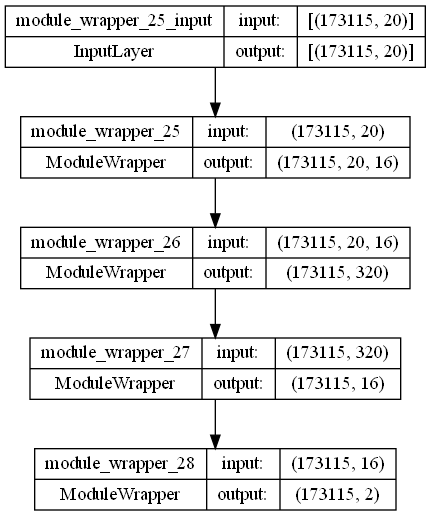

In [157]:
from keras.utils import plot_model
plot_model(model, to_file='model_1_bin.png', show_shapes=True, show_layer_names=True)

In [158]:
history = model.fit(X_train, y_train,
                    batch_size=32,
                    epochs=15,
                    validation_data=(X_val, y_val))

Epoch 1/15
5410/5410 [==============================] - 7s 1ms/step - loss: 0.3039 - accuracy: 0.8859 - val_loss: 0.2845 - val_accuracy: 0.8946
Epoch 2/15
5410/5410 [==============================] - 6s 1ms/step - loss: 0.2786 - accuracy: 0.8974 - val_loss: 0.2840 - val_accuracy: 0.8953
Epoch 3/15
5410/5410 [==============================] - 7s 1ms/step - loss: 0.2751 - accuracy: 0.8988 - val_loss: 0.2801 - val_accuracy: 0.8971
Epoch 4/15
5410/5410 [==============================] - 6s 1ms/step - loss: 0.2732 - accuracy: 0.8991 - val_loss: 0.2794 - val_accuracy: 0.8983
Epoch 5/15
5410/5410 [==============================] - 7s 1ms/step - loss: 0.2717 - accuracy: 0.8999 - val_loss: 0.2784 - val_accuracy: 0.8983
Epoch 6/15
5410/5410 [==============================] - 7s 1ms/step - loss: 0.2705 - accuracy: 0.9002 - val_loss: 0.2795 - val_accuracy: 0.8990
Epoch 7/15
5410/5410 [==============================] - 7s 1ms/step - loss: 0.2700 - accuracy: 0.9005 - val_loss: 0.2776 - val_accuracy:

In [159]:
loss, accuracy = model.evaluate(X_train, y_train, verbose=False)
print("Training Accuracy: {:.4f}".format(accuracy))
loss, accuracy = model.evaluate(X_test, y_test, verbose=False)
print("Testing Accuracy:  {:.4f}".format(accuracy))


Training Accuracy: 0.9025
Testing Accuracy:  0.9001


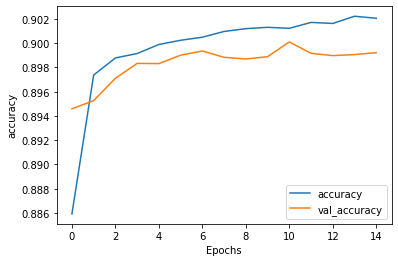

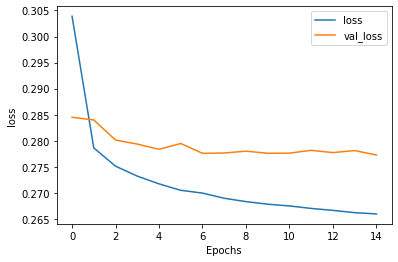

In [160]:
def plot_graphs(history, string):
    plt.plot(history.history[string])
    plt.plot(history.history['val_'+string])
    plt.xlabel("Epochs")
    plt.ylabel(string)
    plt.legend([string, 'val_'+string])
    plt.show()

plot_graphs(history, "accuracy")
plot_graphs(history, "loss")

#### CNN

In [161]:
embedding_dim = 50

model4 = Sequential()
model4.add(Embedding(input_dim=vocab_size, output_dim=embedding_dim, input_length=maxlen))
model4.add(Conv1D(256, 5, activation='relu'))
model4.add(GlobalMaxPool1D())
model4.add(Dense(16, activation='relu'))
model4.add(Dense(2, activation='sigmoid'))

model4.compile(optimizer='adam',
               loss='binary_crossentropy',
               metrics=['accuracy'])
model4.build(X_train.shape) 
model4.summary()

Model: "sequential_7"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 module_wrapper_29 (ModuleWr  (173115, 20, 50)         204050    
 apper)                                                          
                                                                 
 module_wrapper_30 (ModuleWr  (173115, 16, 256)        64256     
 apper)                                                          
                                                                 
 module_wrapper_31 (ModuleWr  (173115, 256)            0         
 apper)                                                          
                                                                 
 module_wrapper_32 (ModuleWr  (173115, 16)             4112      
 apper)                                                          
                                                                 
 module_wrapper_33 (ModuleWr  (173115, 2)             

In [162]:
history_4 = model4.fit(X_train, y_train,
                    batch_size=32,
                    epochs=15,
                    validation_data=(X_val, y_val))

Epoch 1/15
5410/5410 [==============================] - 19s 3ms/step - loss: 0.2975 - accuracy: 0.8899 - val_loss: 0.2889 - val_accuracy: 0.8966
Epoch 2/15
5410/5410 [==============================] - 20s 4ms/step - loss: 0.2762 - accuracy: 0.8997 - val_loss: 0.2777 - val_accuracy: 0.8999
Epoch 3/15
5410/5410 [==============================] - 20s 4ms/step - loss: 0.2719 - accuracy: 0.9015 - val_loss: 0.2806 - val_accuracy: 0.8992
Epoch 4/15
5410/5410 [==============================] - 19s 4ms/step - loss: 0.2697 - accuracy: 0.9025 - val_loss: 0.2768 - val_accuracy: 0.9003
Epoch 5/15
5410/5410 [==============================] - 19s 4ms/step - loss: 0.2680 - accuracy: 0.9028 - val_loss: 0.2771 - val_accuracy: 0.9010
Epoch 6/15
5410/5410 [==============================] - 19s 4ms/step - loss: 0.2671 - accuracy: 0.9032 - val_loss: 0.2763 - val_accuracy: 0.8998
Epoch 7/15
5410/5410 [==============================] - 19s 4ms/step - loss: 0.2660 - accuracy: 0.9031 - val_loss: 0.2766 - val_ac

In [163]:
loss4, accuracy4 = model4.evaluate(X_train, y_train, verbose=False)
print("Training Accuracy: {:.4f}".format(accuracy))
loss, accuracy = model4.evaluate(X_test, y_test, verbose=False)
print("Testing Accuracy:  {:.4f}".format(accuracy))

Training Accuracy: 0.9001
Testing Accuracy:  0.9026


## 3/ Balanced data sample

In [164]:
df_bal=data[['commodity','quantity_name','category']]
#df1=data[['commodity','quantity_name','category']]
df2=df_bal.loc[data['quantity_name'] == 'Weight in kilograms'].sample(n=8000)
df3=df_bal.loc[data['quantity_name'] == 'Number of items'].sample(n=8000)
df4=df_bal.loc[data['quantity_name'] == 'No Quantity'].sample(n=7000)
df5=df_bal.loc[data['quantity_name'] == 'Volume in litres'].sample(n=9000)
df6=df_bal.loc[data['quantity_name'] == 'Area in square metres'].sample(n=9000)
df7=df_bal.loc[data['quantity_name'] == 'Number of pairs'].sample(n=9000)
df8=df_bal.loc[data['quantity_name'] == 'Length in metres'].sample(n=5000)
df9=df_bal.loc[data['quantity_name'] == 'Volume in cubic meters'].sample(n=2000)
df10=df_bal.loc[data['quantity_name'] == 'Weight in carats']
df11=df_bal.loc[data['quantity_name'] == 'Thousands of items']
df12=df_bal.loc[data['quantity_name'] == 'Number of packages']
df13=df_bal.loc[data['quantity_name'] == 'Electrical energy in thousands of kilowatt-hours']


In [165]:
#since our dataset contains all transaction flows from different countries many of the products will be repeated that's why we try to reduce the size of our data by droping the duplicated rows
df_bal.drop_duplicates(inplace=True)
#df=df.append(df1.sample(n=310000))
df_bal=df_bal.append(df13)
df_bal=df_bal.append(df2)
df_bal=df_bal.append(df3)
df_bal=df_bal.append(df4)
df_bal=df_bal.append(df5)
df_bal=df_bal.append(df6)
df_bal=df_bal.append(df7)
df_bal=df_bal.append(df8)
df_bal=df_bal.append(df9)
df_bal=df_bal.append(df10)
df_bal=df_bal.append(df11)
df_bal=df_bal.append(df12)

C:\Users\utilisateur\AppData\Local\Temp\ipykernel_31320\3077937468.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_bal.drop_duplicates(inplace=True)
C:\Users\utilisateur\AppData\Local\Temp\ipykernel_31320\3077937468.py:4: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_bal=df_bal.append(df13)
C:\Users\utilisateur\AppData\Local\Temp\ipykernel_31320\3077937468.py:5: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_bal=df_bal.append(df2)
C:\Users\utilisateur\AppData\Local\Temp\ipykernel_31320\3077937468.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use panda

In [166]:
df_bal['quantity_name'].value_counts()

Weight in kilograms                                 12947
No Quantity                                         11295
Number of items                                     10171
Area in square metres                                9473
Volume in litres                                     9348
Number of pairs                                      9062
Length in metres                                     5413
Weight in carats                                     3890
Volume in cubic meters                               2028
Thousands of items                                   1384
Number of packages                                   1040
Electrical energy in thousands of kilowatt-hours       76
Name: quantity_name, dtype: int64

<AxesSubplot:>

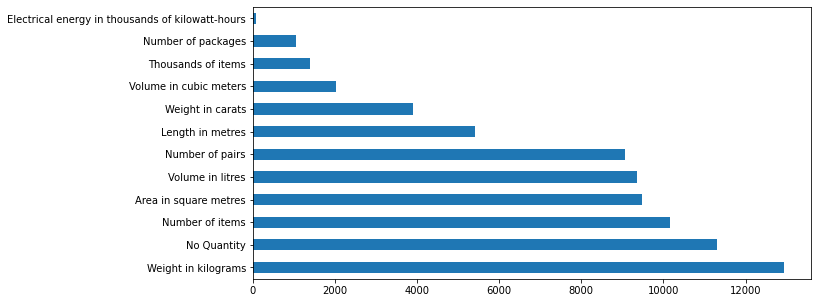

In [167]:
fig,ax=plt.subplots(figsize=(10,5))
df_bal['quantity_name'].value_counts().plot(kind='barh')

In [168]:
df_bal.reset_index(inplace=True)

In [169]:
df_bal['commodity'][16]

'Bovine animals, live pure-bred breeding'

In [170]:
df_bal['commodity'] = df_bal['commodity'].apply(remove_punctuation)
df_bal['commodity'] = df_bal['commodity'].apply(remove_stopwords)
df_bal['commodity'] = df_bal['commodity'].apply(stemmer)

In [171]:
vectorizer = CountVectorizer()
vectorizer.fit(df_bal['commodity'])
vector = vectorizer.transform(df_bal['commodity'])
print(vector.shape)
print(vector.toarray())

(76127, 4075)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]


In [172]:
# extract the tfid representation matrix of the text data
tfidf_converter = TfidfTransformer()
X_tfidf = tfidf_converter.fit_transform(vector).toarray()
X_tfidf

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])

In [173]:
X = df_bal['commodity']
y = df_bal['quantity_name']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state = 123)
X_train.shape, X_test.shape, y_train.shape, y_test.shape

((57095,), (19032,), (57095,), (19032,))

### SVC

In [174]:
svc = Pipeline([('vect', CountVectorizer(min_df=5, ngram_range=(1,2))),
               ('tfidf', TfidfTransformer()),
               ('model',LinearSVC()),
               ])

svc.fit(X_train, y_train)

ytest = np.array(y_test)
y_pred = svc.predict(X_test)

print('accuracy %s' % accuracy_score(y_pred, ytest))
print(classification_report(ytest,y_pred))

accuracy 0.7673392181588903
                                                  precision    recall  f1-score   support

                           Area in square metres       0.85      0.85      0.85      2350
Electrical energy in thousands of kilowatt-hours       0.73      1.00      0.84        16
                                Length in metres       0.71      0.87      0.78      1364
                                     No Quantity       0.52      0.37      0.43      2840
                                 Number of items       0.76      0.80      0.78      2579
                              Number of packages       0.99      1.00      1.00       257
                                 Number of pairs       0.97      0.99      0.98      2247
                              Thousands of items       0.99      1.00      1.00       368
                          Volume in cubic meters       0.83      1.00      0.91       512
                                Volume in litres       0.95      0.92  

### Random Forest

In [175]:
rf = Pipeline([('vect', CountVectorizer(min_df=5, ngram_range=(1,2))),
               ('tfidf', TfidfTransformer()),
               ('rf', RandomForestClassifier(n_estimators=50)),
               ])

rf.fit(X_train, y_train)

ytest = np.array(y_test)
preds = rf.predict(X_test)

print('accuracy %s' % accuracy_score(preds, y_test))
print(classification_report(ytest, preds))

accuracy 0.758932324506095
                                                  precision    recall  f1-score   support

                           Area in square metres       0.85      0.86      0.85      2350
Electrical energy in thousands of kilowatt-hours       0.73      1.00      0.84        16
                                Length in metres       0.71      0.86      0.78      1364
                                     No Quantity       0.49      0.38      0.43      2840
                                 Number of items       0.75      0.79      0.77      2579
                              Number of packages       0.99      1.00      1.00       257
                                 Number of pairs       0.97      1.00      0.98      2247
                              Thousands of items       0.99      1.00      1.00       368
                          Volume in cubic meters       0.83      1.00      0.91       512
                                Volume in litres       0.94      0.92   

### Naive Bayes

In [176]:
nbc = Pipeline([('vect', CountVectorizer(min_df=3, ngram_range=(1,2))),
               ('tfidf', TfidfTransformer()),
               ('model',MultinomialNB()),
               ])

nbc.fit(X_train, y_train)

ytest = np.array(y_test)
pred_y = nbc.predict(X_test)


print('accuracy %s' % accuracy_score(pred_y, y_test))
print(classification_report(ytest, pred_y))

accuracy 0.7682849936948297


C:\Users\utilisateur\.conda\envs\python\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


                                                  precision    recall  f1-score   support

                           Area in square metres       0.83      0.86      0.84      2350
Electrical energy in thousands of kilowatt-hours       0.00      0.00      0.00        16
                                Length in metres       0.71      0.85      0.77      1364
                                     No Quantity       0.56      0.36      0.44      2840
                                 Number of items       0.73      0.81      0.77      2579
                              Number of packages       0.99      1.00      1.00       257
                                 Number of pairs       0.96      0.99      0.98      2247
                              Thousands of items       0.99      1.00      1.00       368
                          Volume in cubic meters       0.81      0.98      0.89       512
                                Volume in litres       0.93      0.92      0.93      2261
         

C:\Users\utilisateur\.conda\envs\python\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\utilisateur\.conda\envs\python\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


### looking for the optimal data distribution to achieve the best result

In [ ]:
df_bal2=data[['commodity','quantity_name','category']]
#df1=data[['commodity','quantity_name','category']]
df2=df_bal2.loc[data['quantity_name'] == 'Weight in kilograms'].sample(n=35000)
df3=df_bal2.loc[data['quantity_name'] == 'Number of items'].sample(n=30000)
df4=df_bal2.loc[data['quantity_name'] == 'No Quantity'].sample(n=7000)
df5=df_bal2.loc[data['quantity_name'] == 'Volume in litres'].sample(n=19000)
df6=df_bal2.loc[data['quantity_name'] == 'Area in square metres'].sample(n=20000)
df7=df_bal2.loc[data['quantity_name'] == 'Number of pairs'].sample(n=14000)
df8=df_bal2.loc[data['quantity_name'] == 'Length in metres']
df9=df_bal2.loc[data['quantity_name'] == 'Volume in cubic meters'].sample(n=13000)
df10=df_bal2.loc[data['quantity_name'] == 'Weight in carats']
df11=df_bal2.loc[data['quantity_name'] == 'Thousands of items']
df12=df_bal2.loc[data['quantity_name'] == 'Number of packages']
df13=df_bal2.loc[data['quantity_name'] == 'Electrical energy in thousands of kilowatt-hours']

In [ ]:
#since our dataset contains all transaction flows from different countries many of the products will be repeated that's why we try to reduce the size of our data by droping the duplicated rows
df_bal2.drop_duplicates(inplace=True)
#df=df.append(df1.sample(n=310000))
df_bal2=df_bal2.append(df13)
df_bal2=df_bal2.append(df2)
df_bal2=df_bal2.append(df3)
df_bal2=df_bal2.append(df4)
df_bal2=df_bal2.append(df5)
df_bal2=df_bal2.append(df6)
df_bal2=df_bal2.append(df7)
df_bal2=df_bal2.append(df8)
df_bal2=df_bal2.append(df9)
df_bal2=df_bal2.append(df10)
df_bal2=df_bal2.append(df11)
df_bal2=df_bal2.append(df12)

In [ ]:
df_bal2=df_bal2.loc[data['quantity_name'] != 'Electrical energy in thousands of kilowatt-hours']
df_bal2=df_bal2.loc[data['quantity_name'] != 'No Quantity']

In [ ]:
df_bal2['quantity_name'].value_counts()

In [ ]:
fig,ax=plt.subplots(figsize=(10,5))
df_bal2['quantity_name'].value_counts().plot(kind='barh')

In [ ]:
df_bal2.reset_index(inplace=True)

In [ ]:
df_bal2['commodity'] = df_bal2['commodity'].apply(remove_punctuation)
df_bal2['commodity'] = df_bal2['commodity'].apply(remove_stopwords)
df_bal2['commodity'] = df_bal2['commodity'].apply(stemmer)

In [ ]:
vectorizer = CountVectorizer()
vectorizer.fit(df_bal2['commodity'])
vector = vectorizer.transform(df_bal2['commodity'])
print(vector.shape)
print(vector.toarray())

In [ ]:
# extract the tfid representation matrix of the text data
tfidf_converter = TfidfTransformer()
X_tfidf = tfidf_converter.fit_transform(vector).toarray()
X_tfidf

In [ ]:
X = df_bal2['commodity']
y = df_bal2['quantity_name']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state = 123)
X_train.shape, X_test.shape, y_train.shape, y_test.shape

### SVC

In [135]:
svc = Pipeline([('vect', CountVectorizer(min_df=5, ngram_range=(1,2))),
               ('tfidf', TfidfTransformer()),
               ('model',LinearSVC()),
               ])

svc.fit(X_train, y_train)

ytest = np.array(y_test)
y_pred = svc.predict(X_test)

print('accuracy %s' % accuracy_score(y_pred, ytest))
print(classification_report(ytest,y_pred))

accuracy 0.9119510757441792
                        precision    recall  f1-score   support

 Area in square metres       0.93      0.85      0.89      5198
      Length in metres       0.79      0.92      0.85      4331
       Number of items       0.92      0.93      0.93      8122
    Number of packages       0.99      1.00      0.99       240
       Number of pairs       0.97      0.99      0.98      3473
    Thousands of items       0.99      1.00      1.00       343
Volume in cubic meters       0.95      1.00      0.97      3320
      Volume in litres       0.96      0.93      0.95      4791
      Weight in carats       1.00      1.00      1.00       971
   Weight in kilograms       0.88      0.85      0.86      9927

              accuracy                           0.91     40716
             macro avg       0.94      0.95      0.94     40716
          weighted avg       0.91      0.91      0.91     40716



### Naive Bayes

In [136]:
nbc = Pipeline([('vect', CountVectorizer(min_df=3, ngram_range=(1,2))),
               ('tfidf', TfidfTransformer()),
               ('model',MultinomialNB()),
               ])

nbc.fit(X_train, y_train)

ytest = np.array(y_test)
pred_y = nbc.predict(X_test)


print('accuracy %s' % accuracy_score(pred_y, y_test))
print(classification_report(ytest, pred_y))

accuracy 0.902667256115532
                        precision    recall  f1-score   support

 Area in square metres       0.89      0.86      0.87      5198
      Length in metres       0.79      0.91      0.84      4331
       Number of items       0.90      0.93      0.91      8122
    Number of packages       0.99      1.00      0.99       240
       Number of pairs       0.97      0.99      0.98      3473
    Thousands of items       0.99      1.00      1.00       343
Volume in cubic meters       0.94      1.00      0.97      3320
      Volume in litres       0.96      0.94      0.95      4791
      Weight in carats       0.98      1.00      0.99       971
   Weight in kilograms       0.89      0.81      0.85      9927

              accuracy                           0.90     40716
             macro avg       0.93      0.94      0.94     40716
          weighted avg       0.90      0.90      0.90     40716



### Random Forest

In [137]:
rf = Pipeline([('vect', CountVectorizer(min_df=5, ngram_range=(1,2))),
               ('tfidf', TfidfTransformer()),
               ('rf', RandomForestClassifier(n_estimators=50)),
               ])

rf.fit(X_train, y_train)

ytest = np.array(y_test)
preds = rf.predict(X_test)

print('accuracy %s' % accuracy_score(preds, y_test))
print(classification_report(ytest, preds))

accuracy 0.9110423420768249
                        precision    recall  f1-score   support

 Area in square metres       0.93      0.85      0.89      5198
      Length in metres       0.79      0.92      0.85      4331
       Number of items       0.92      0.93      0.92      8122
    Number of packages       0.99      1.00      0.99       240
       Number of pairs       0.97      0.99      0.98      3473
    Thousands of items       0.99      1.00      1.00       343
Volume in cubic meters       0.95      1.00      0.97      3320
      Volume in litres       0.96      0.93      0.95      4791
      Weight in carats       1.00      1.00      1.00       971
   Weight in kilograms       0.88      0.84      0.86      9927

              accuracy                           0.91     40716
             macro avg       0.94      0.95      0.94     40716
          weighted avg       0.91      0.91      0.91     40716



#### we can conclude that even though the accuracy may seem the same as when we used the random sample at first, the precision and f1 score for each class is different in this case 

## Clustering the commodities
#### in this part we'll apply clustering algorithms to our data sample and try to establish groups of products based on their quantity, weight and value
#### We'll then observe how this distribution is in regards of the hs code and other variables

In [66]:
#df_clust=data[['commodity','quantity_name','comm_code','trade_usd','weight_kg','quantity']]
#df1=data[['commodity','quantity_name','category']]
df2=data.loc[data['quantity_name'] == 'Weight in kilograms'].sample(n=12000)
df3=data.loc[data['quantity_name'] == 'Number of items'].sample(n=10000)
df4=data.loc[data['quantity_name'] == 'No Quantity'].sample(n=7000)
df5=data.loc[data['quantity_name'] == 'Volume in litres'].sample(n=8000)
df6=data.loc[data['quantity_name'] == 'Area in square metres'].sample(n=9000)
df7=data.loc[data['quantity_name'] == 'Number of pairs'].sample(n=6000)
df8=data.loc[data['quantity_name'] == 'Length in metres']
df9=data.loc[data['quantity_name'] == 'Volume in cubic meters'].sample(n=7000)
df10=data.loc[data['quantity_name'] == 'Weight in carats']
df11=data.loc[data['quantity_name'] == 'Thousands of items']
df12=data.loc[data['quantity_name'] == 'Number of packages']
df13=data.loc[data['quantity_name'] == 'Electrical energy in thousands of kilowatt-hours']

In [67]:
#since our dataset contains all transaction flows from different countries many of the products will be repeated that's why we try to reduce the size of our data by droping the duplicated rows
#df_clust.drop_duplicates(inplace=True)
#df=df.append(df1.sample(n=310000))
df_clust=df13.append(df2)
#df_clust=df_clust.append(df2)
df_clust=df_clust.append(df3)
df_clust=df_clust.append(df4)
df_clust=df_clust.append(df5)
df_clust=df_clust.append(df6)
df_clust=df_clust.append(df7)
df_clust=df_clust.append(df8)
df_clust=df_clust.append(df9)
df_clust=df_clust.append(df10)
df_clust=df_clust.append(df11)
df_clust=df_clust.append(df12)

C:\Users\utilisateur\AppData\Local\Temp\ipykernel_33968\510031963.py:4: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_clust=df13.append(df2)
C:\Users\utilisateur\AppData\Local\Temp\ipykernel_33968\510031963.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_clust=df_clust.append(df3)
C:\Users\utilisateur\AppData\Local\Temp\ipykernel_33968\510031963.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_clust=df_clust.append(df4)
C:\Users\utilisateur\AppData\Local\Temp\ipykernel_33968\510031963.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_clust=df_clust.append(df5)
C:\Users\utilisateur\AppData\Local\Temp\ipykernel_33968\

In [14]:
from sklearn.preprocessing import MinMaxScaler, scale
from sklearn.cluster import KMeans, AgglomerativeClustering
from sklearn.metrics import silhouette_score, classification_report
from pyclustertend import hopkins,vat
import scipy.cluster.hierarchy as sch
import yellowbrick
from yellowbrick.cluster import KElbowVisualizer

In [69]:
df_clust=df_clust.loc[df_clust['comm_code'] != '9999AA']
df_clust=df_clust.loc[df_clust['comm_code'] != 'TOTAL']

In [70]:
df_clust['comm_code']=pd.to_numeric(df_clust['comm_code'])

In [71]:
df_clust

,country_or_area,year,comm_code,commodity,flow,trade_usd,weight_kg,quantity_name,quantity,category
2195538,Albania,2006,271600,Electrical energy,Import,38952008,36.0,Electrical energy in thousands of kilowatt-hours,426776.0,27_mineral_fuels_oils_distillation_products_etc
2196983,Algeria,1995,271600,Electrical energy,Import,97311,0.0,Electrical energy in thousands of kilowatt-hours,58160.0,27_mineral_fuels_oils_distillation_products_etc
2197126,Algeria,1992,271600,Electrical energy,Import,3658,0.0,Electrical energy in thousands of kilowatt-hours,30.0,27_mineral_fuels_oils_distillation_products_etc
2197127,Algeria,1992,271600,Electrical energy,Export,63528368,0.0,Electrical energy in thousands of kilowatt-hours,238434864.0,27_mineral_fuels_oils_distillation_products_etc
2198982,Argentina,2005,271600,Electrical energy,Import,262737245,2.0,Electrical energy in thousands of kilowatt-hours,6750700.0,27_mineral_fuels_oils_distillation_products_etc
...,...,...,...,...,...,...,...,...,...,...
8069532,Ireland,2009,950440,Playing cards,Import,6271195,954085.0,Number of packages,6075899.0,95_toys_games_sports_requisites
8069589,Ireland,2008,950440,Playing cards,Import,9466299,979138.0,Number of packages,10590660.0,95_toys_games_sports_requisites
8069590,Ireland,2008,950440,Playing cards,Export,2427395,377173.0,Number of packages,1497890.0,95_toys_games_sports_requisites
8069647,Ireland,2007,950440,Playing cards,Import,7544132,1054913.0,Number of packages,7478965.0,95_toys_games_sports_requisites


In [72]:
dat=df_clust[['trade_usd','weight_kg','quantity']]

In [73]:
dat

,trade_usd,weight_kg,quantity
2195538,38952008,36.0,426776.0
2196983,97311,0.0,58160.0
2197126,3658,0.0,30.0
2197127,63528368,0.0,238434864.0
2198982,262737245,2.0,6750700.0
...,...,...,...
8069532,6271195,954085.0,6075899.0
8069589,9466299,979138.0,10590660.0
8069590,2427395,377173.0,1497890.0
8069647,7544132,1054913.0,7478965.0


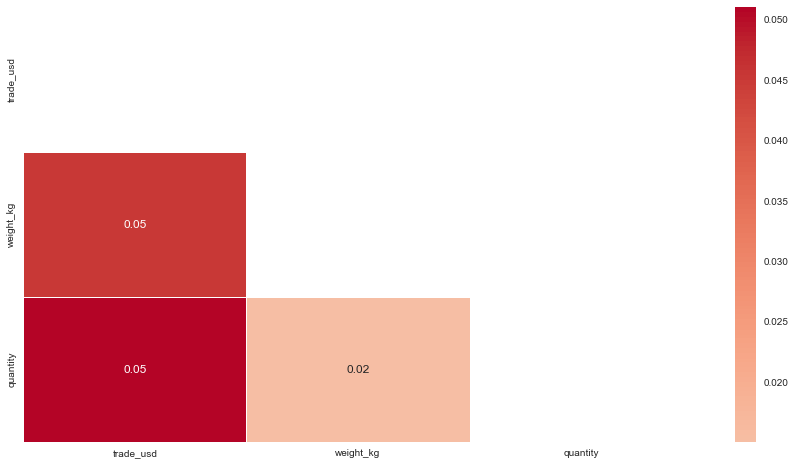

In [74]:
corr = dat.corr()
mask = np.triu(np.ones_like(corr, dtype=bool))
# Draw the heatmap
fig, ax = plt.subplots(figsize=(15,8))
sns.heatmap(corr, mask=mask,  cmap="coolwarm", center=0, linewidths=1, annot=True, fmt=".2f")
plt.show()

In [75]:
dat.describe().T

,count,mean,std,min,25%,50%,75%,max
trade_usd,82444.0,2.537985e+07,3.258562e+08,1.0,13723.0,197742.0,2515286.50,3.247423e+10
weight_kg,82444.0,5.507950e+07,4.559006e+09,0.0,1.0,3524.5,182561.50,7.985015e+11
quantity,82444.0,1.445954e+09,3.000503e+11,0.0,403.0,22084.0,551369.75,7.902216e+13


In [76]:
inputs = ['trade_usd','weight_kg','quantity']
scaler = MinMaxScaler()
dat[inputs] = scaler.fit_transform(dat[inputs])

dat.describe().T

C:\Users\utilisateur\AppData\Local\Temp\ipykernel_33968\625744112.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dat[inputs] = scaler.fit_transform(dat[inputs])


,count,mean,std,min,25%,50%,75%,max
trade_usd,82444.0,0.000782,0.010034,0.0,4.225505e-07,6.089167e-06,7.745482e-05,1.0
weight_kg,82444.0,0.000069,0.005709,0.0,1.252346e-12,4.413893e-09,2.286301e-07,1.0
quantity,82444.0,0.000018,0.003797,0.0,5.099836e-12,2.794659e-10,6.977407e-09,1.0


In [77]:
hopkins(scale(dat),dat.shape[0])

5.965095528312303e-05

In [78]:
def find_k(range_n_clusters):
    ssd = []
    silhoutte_scores = []

    for num_clusters in range_n_clusters:
        kmeans = KMeans(n_clusters=num_clusters, max_iter=50)
        kmeans.fit(dat)
        labels=kmeans.predict(dat)
        silhouette = silhouette_score(dat,labels)
        silhoutte_scores.append(silhouette)
        ssd.append(kmeans.inertia_)
    
    fig, axs = plt.subplots(1, 2, figsize=(10,5))
    
    axs[0].plot(ssd)
    axs[0].set_xlabel('K Value')
    axs[0].set_ylabel('Inertia')

    axs[1].plot(silhoutte_scores)
    axs[1].set_xlabel('K Value')
    axs[1].set_ylabel('Silhouette Scores')
    
    plt.tight_layout()

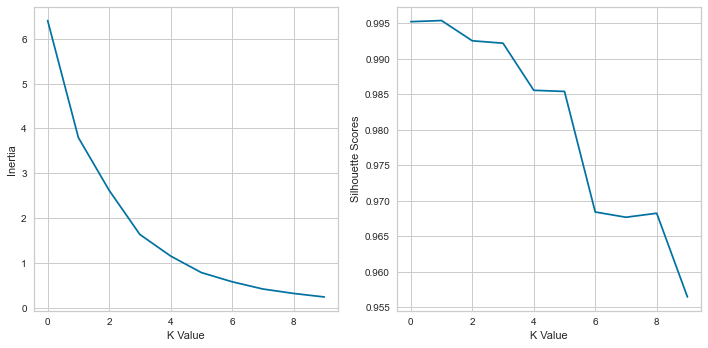

In [79]:
find_k([2, 3, 4, 5, 6, 7, 8, 9, 10, 11])

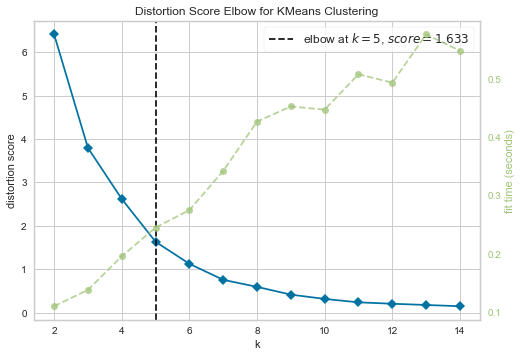

<AxesSubplot:title={'center':'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [80]:
kmeans = KMeans()
visualizer = KElbowVisualizer(kmeans, k=(2,15))
visualizer.fit(dat)
visualizer.show()

In [81]:
kmeans = KMeans(n_clusters=8,random_state=40)
kmeans.fit(dat)
kmeans.cluster_centers_

array([[3.34075880e-04, 2.14789891e-05, 4.82794846e-07],
       [1.84552068e-01, 6.79815794e-03, 4.22787021e-05],
       [1.13945449e-02, 9.33387162e-01, 9.43167149e-03],
       [5.41349766e-02, 2.51916392e-03, 1.38296113e-05],
       [7.61773020e-02, 0.00000000e+00, 4.33897577e-01],
       [1.00000000e+00, 4.63076621e-02, 4.67928716e-04],
       [3.77269355e-01, 1.07146238e-04, 1.94484737e-06],
       [1.26792751e-01, 0.00000000e+00, 1.00000000e+00]])

In [82]:
preds = kmeans.predict(dat)
preds

array([0, 0, 0, ..., 0, 0, 0])

In [83]:
silhouette_score(dat,preds)

0.9851272766365405

In [84]:
dat['class'] = preds

C:\Users\utilisateur\AppData\Local\Temp\ipykernel_33968\3150866059.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dat['class'] = preds


In [85]:
df_clust['class'] = preds

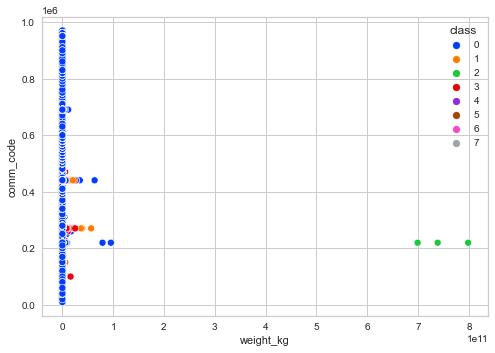

In [86]:
sns.scatterplot(data=df_clust,x='weight_kg',y='comm_code',hue='class',palette='bright');

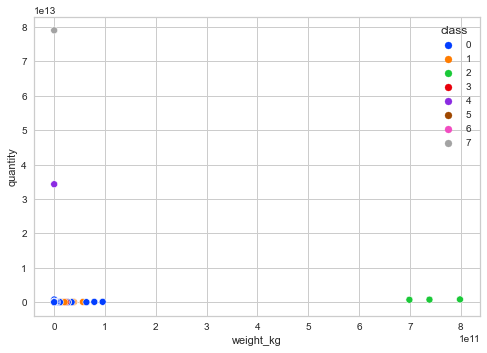

In [87]:
sns.scatterplot(data=df_clust,x='weight_kg',y='quantity',hue='class',palette='bright');

In [88]:
import plotly.express as px

  
fig = px.scatter_3d(df_clust, x = 'weight_kg', 
                    y = 'quantity', 
                    z = 'comm_code',
                    color = 'class')
  
fig.show()

In [89]:
fig2 = px.scatter_3d(df_clust, x = 'weight_kg', 
                    y = 'comm_code', 
                    z = 'trade_usd',
                    color = 'class')
  
fig2.show()

In [90]:
fig3 = px.scatter_3d(df_clust, x = 'weight_kg', 
                    y = 'quantity', 
                    z = 'trade_usd',
                    color = 'class')
  
fig3.show()

## Regression:

In [196]:
df_reg=data
df_reg=df_reg.loc[df_reg['quantity_name'] != 'Weight in kilograms']
df_reg=df_reg.loc[df_reg['quantity_name'] != 'No Quantity']
df_reg['category'].unique()

array(['01_live_animals', '02_meat_and_edible_meat_offal',
       '03_fish_crustaceans_molluscs_aquatic_invertebrates_ne',
       '04_dairy_products_eggs_honey_edible_animal_product_nes',
       '05_products_of_animal_origin_nes',
       '06_live_trees_plants_bulbs_roots_cut_flowers_etc',
       '07_edible_vegetables_and_certain_roots_and_tubers',
       '08_edible_fruit_nuts_peel_of_citrus_fruit_melons',
       '09_coffee_tea_mate_and_spices',
       '11_milling_products_malt_starches_inulin_wheat_glute',
       '12_oil_seed_oleagic_fruits_grain_seed_fruit_etc_ne',
       '13_lac_gums_resins_vegetable_saps_and_extracts_nes',
       '14_vegetable_plaiting_materials_vegetable_products_nes',
       '15_animal_vegetable_fats_and_oils_cleavage_products_et',
       '16_meat_fish_and_seafood_food_preparations_nes',
       '17_sugars_and_sugar_confectionery',
       '18_cocoa_and_cocoa_preparations',
       '19_cereal_flour_starch_milk_preparations_and_products',
       '20_vegetable_fruit_nu

In [1251]:

df_reg2=df_reg.loc[df_reg['category'] == '20_vegetable_fruit_nut_etc_food_preparations']
#df_reg=df_reg.loc[df_reg['comm_code'] != '9999AA']
#df_reg=df_reg.loc[df_reg['comm_code'] != 'TOTAL']
df_reg3=df_reg2[['trade_usd','weight_kg','quantity']]
df_reg3

,trade_usd,weight_kg,quantity
1579244,280320,408731.0,408731.0
1579245,6268,10062.0,10062.0
1579246,122491,242619.0,242619.0
1579247,16277,75601.0,75601.0
1579248,32391,73440.0,73440.0
...,...,...,...
1677616,780116,836416.0,836416.0
1677617,1427567,1279881.0,1279881.0
1677618,1610,148.0,148.0
1677619,383153,312603.0,312603.0


In [1252]:
sns.pairplot(df_reg3)

KeyboardInterrupt: 

Error in callback <function flush_figures at 0x00000253735AEB90> (for post_execute):


KeyboardInterrupt: 

In [ ]:
import hvplot.pandas

In [1253]:
df_reg3.hvplot.hist(by='weight_kg', subplots=False, width=1000)

:NdOverlay   [Element]
   :Histogram   [quantity]   (quantity_count)

In [1254]:
df_reg3.hvplot.hist("trade_usd")

:Histogram   [trade_usd]   (trade_usd_count)

<AxesSubplot:>

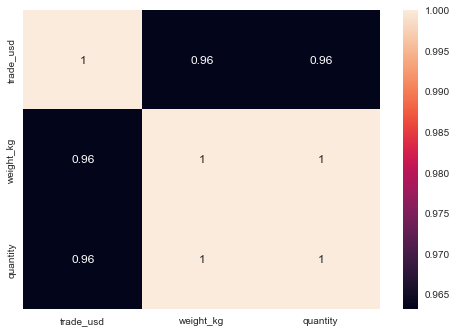

In [1255]:
sns.heatmap(df_reg3.corr(), annot=True)

In [1256]:
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
Y= df_reg3['quantity']
X=df_reg3[['trade_usd','weight_kg']]
X_train, X_test, Y_train, Y_test = train_test_split(X,Y, test_size=0.20, random_state = 123)

pipeline = Pipeline([
    ('std_scalar', StandardScaler())
])
X_train = pipeline.fit_transform(X_train)
X_test = pipeline.transform(X_test)

X_train, X_val, Y_train, Y_val = train_test_split(X_train,Y_train, test_size=0.20, random_state = 123)


In [1257]:
from sklearn import metrics
from sklearn.model_selection import cross_val_score

def cross_val(model):
    pred = cross_val_score(model, X, Y, cv=10)
    return pred.mean()

def print_evaluate(true, predicted):  
    mae = metrics.mean_absolute_error(true, predicted)
    mse = metrics.mean_squared_error(true, predicted)
    rmse = np.sqrt(metrics.mean_squared_error(true, predicted))
    r2_square = metrics.r2_score(true, predicted)
    print('MAE:', mae)
    print('MSE:', mse)
    print('RMSE:', rmse)
    print('R2 Square', r2_square)
    print('__________________________________')
    
def evaluate(true, predicted):
    mae = metrics.mean_absolute_error(true, predicted)
    mse = metrics.mean_squared_error(true, predicted)
    rmse = np.sqrt(metrics.mean_squared_error(true, predicted))
    r2_square = metrics.r2_score(true, predicted)
    return mae, mse, rmse, r2_square

In [1258]:
#from sklearn.neural_network import MLPRegressor

#model=MLPRegressor(activation='relu',solver='adam', alpha=0.0001, batch_size='auto', learning_rate='constant')

#model.fit(X_train,Y_train)

In [1259]:
from sklearn.linear_model import LinearRegression

lin_reg = LinearRegression(normalize=True)
lin_reg.fit(X_train,Y_train)

C:\Users\utilisateur\.conda\envs\python\lib\site-packages\sklearn\linear_model\_base.py:141: FutureWarning: 'normalize' was deprecated in version 1.0 and will be removed in 1.2.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LinearRegression())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)


  warnings.warn(


LinearRegression(normalize=True)

In [1260]:
# print the intercept
print(lin_reg.intercept_)

7468691.688330964


In [1261]:
coeff_df = pd.DataFrame(lin_reg.coef_, X.columns, columns=['Coefficient'])
coeff_df

,Coefficient
trade_usd,3.240796e+04
weight_kg,5.255129e+07


In [1262]:
pred = lin_reg.predict(X_test)

In [1263]:
pd.DataFrame({'True Values': Y_test, 'Predicted Values': pred}).hvplot.scatter(x='True Values', y='Predicted Values')

:Scatter   [True Values]   (Predicted Values)

In [1264]:
pred[:10]

array([7.33110435e+04, 1.47819974e+06, 5.09815311e+06, 3.31644452e+04,
       4.48204066e+05, 1.58871407e+06, 3.24520053e+04, 3.42184675e+08,
       8.47408845e+05, 1.69648929e+06])

In [1265]:
Y_test[:10]

1588466        48875.0
1609720      1454138.0
1589296      5070173.0
1612405         8717.0
1628090       423671.0
1588822      1563167.0
1638582         8000.0
1601077    342157664.0
1625513       823042.0
1674998      1671948.0
Name: quantity, dtype: float64

In [1266]:
pd.DataFrame({'Error Values': (Y_test - pred)}).hvplot.kde()

:Distribution   [Error Values]   (Density)

In [1267]:
test_pred = lin_reg.predict(X_test)
train_pred = lin_reg.predict(X_train)

print('Test set evaluation:\n_____________________________________')
print_evaluate(Y_test, test_pred)
print('Train set evaluation:\n_____________________________________')
print_evaluate(Y_train, train_pred)

results_df = pd.DataFrame(data=[["Linear Regression", *evaluate(Y_test, test_pred) ]], 
                          columns=['Model', 'MAE', 'MSE', 'RMSE', 'R2 Square'])

Test set evaluation:
_____________________________________
MAE: 47355.764364828676
MSE: 271370965602.00977
RMSE: 520932.7841497497
R2 Square 0.9998212476213657
__________________________________
Train set evaluation:
_____________________________________
MAE: 48501.056939767856
MSE: 218890976403.26056
RMSE: 467857.8591872328
R2 Square 0.9999104443629201
__________________________________


In [1268]:
from sklearn.linear_model import RANSACRegressor

model = RANSACRegressor(base_estimator=LinearRegression(), max_trials=100)
model.fit(X_train, Y_train)

test_pred = model.predict(X_test)
train_pred = model.predict(X_train)

print('Test set evaluation:\n_____________________________________')
print_evaluate(Y_test, test_pred)
print('====================================')
print('Train set evaluation:\n_____________________________________')
print_evaluate(Y_train, train_pred)


results_df_2 = pd.DataFrame(data=[["Robust Regression", *evaluate(Y_test, test_pred) ]], 
                            columns=['Model', 'MAE', 'MSE', 'RMSE', 'R2 Square'])

results_df = results_df.append(results_df_2, ignore_index=True)

Test set evaluation:
_____________________________________
MAE: 23192.013876684297
MSE: 272105597785.26746
RMSE: 521637.41984760587
R2 Square 0.9998207637182707
__________________________________
Train set evaluation:
_____________________________________
MAE: 24106.02658335272
MSE: 219558996808.26276
RMSE: 468571.2291725376
R2 Square 0.9999101710533761
__________________________________


C:\Users\utilisateur\.conda\envs\python\lib\site-packages\sklearn\linear_model\_ransac.py:320: FutureWarning: `base_estimator` was renamed to `estimator` in version 1.1 and will be removed in 1.3.
  warnings.warn(
C:\Users\utilisateur\AppData\Local\Temp\ipykernel_18456\2841673892.py:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append(results_df_2, ignore_index=True)


In [1269]:
pd.DataFrame({'True Values': Y_test, 'Predicted Values': test_pred}).hvplot.scatter(x='True Values', y='Predicted Values')

:Scatter   [True Values]   (Predicted Values)

In [1270]:
from sklearn.linear_model import Ridge

model = Ridge(alpha=100, solver='cholesky', tol=0.0001, random_state=42)
model.fit(X_train, Y_train)
pred = model.predict(X_test)

test_pred = model.predict(X_test)
train_pred = model.predict(X_train)

print('Test set evaluation:\n_____________________________________')
print_evaluate(Y_test, test_pred)
print('====================================')
print('Train set evaluation:\n_____________________________________')
print_evaluate(Y_train, train_pred)

results_df_2 = pd.DataFrame(data=[["Ridge Regression", *evaluate(Y_test, test_pred) ]], 
                            columns=['Model', 'MAE', 'MSE', 'RMSE', 'R2 Square'])
results_df = results_df.append(results_df_2, ignore_index=True)

Test set evaluation:
_____________________________________
MAE: 471799.77457069367
MSE: 2870963944320.5854
RMSE: 1694391.9098958734
R2 Square 0.9981088926264382
__________________________________
Train set evaluation:
_____________________________________
MAE: 573356.6191365245
MSE: 8312243563620.188
RMSE: 2883096.1766164145
R2 Square 0.9965991824782591
__________________________________


C:\Users\utilisateur\AppData\Local\Temp\ipykernel_18456\1633383559.py:18: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append(results_df_2, ignore_index=True)


In [1271]:
pd.DataFrame({'True Values': Y_test, 'Predicted Values': test_pred}).hvplot.scatter(x='True Values', y='Predicted Values')

:Scatter   [True Values]   (Predicted Values)

In [1272]:
from sklearn.preprocessing import PolynomialFeatures

poly_reg = PolynomialFeatures(degree=2)

X_train_2_d = poly_reg.fit_transform(X_train)
X_test_2_d = poly_reg.transform(X_test)

lin_reg = LinearRegression(normalize=True)
lin_reg.fit(X_train_2_d,Y_train)

test_pred = lin_reg.predict(X_test_2_d)
train_pred = lin_reg.predict(X_train_2_d)

print('Test set evaluation:\n_____________________________________')
print_evaluate(Y_test, test_pred)
print('====================================')
print('Train set evaluation:\n_____________________________________')
print_evaluate(Y_train, train_pred)

results_df_2 = pd.DataFrame(data=[["Polynomail Regression", *evaluate(Y_test, test_pred)]], 
                            columns=['Model', 'MAE', 'MSE', 'RMSE', 'R2 Square'])
results_df = results_df.append(results_df_2, ignore_index=True)

Test set evaluation:
_____________________________________
MAE: 48671.65776079831
MSE: 271058441137.69934
RMSE: 520632.73152741685
R2 Square 0.999821453481603
__________________________________
Train set evaluation:
_____________________________________
MAE: 49869.31728071925
MSE: 218681446485.49875
RMSE: 467633.8808143597
R2 Square 0.9999105300886343
__________________________________


C:\Users\utilisateur\.conda\envs\python\lib\site-packages\sklearn\linear_model\_base.py:141: FutureWarning: 'normalize' was deprecated in version 1.0 and will be removed in 1.2.
If you wish to scale the data, use Pipeline with a StandardScaler in a preprocessing stage. To reproduce the previous behavior:

from sklearn.pipeline import make_pipeline

model = make_pipeline(StandardScaler(with_mean=False), LinearRegression())

If you wish to pass a sample_weight parameter, you need to pass it as a fit parameter to each step of the pipeline as follows:

kwargs = {s[0] + '__sample_weight': sample_weight for s in model.steps}
model.fit(X, y, **kwargs)


  warnings.warn(
C:\Users\utilisateur\AppData\Local\Temp\ipykernel_18456\3437779118.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append(results_df_2, ignore_index=True)


In [1273]:
pd.DataFrame({'True Values': Y_test, 'Predicted Values': test_pred}).hvplot.scatter(x='True Values', y='Predicted Values')

:Scatter   [True Values]   (Predicted Values)

In [130]:
#scaler = MinMaxScaler()
#df_reg=data
#df_reg[['trade_usd','weight_kg','quantity']] = scaler.fit_transform(data[['trade_usd','weight_kg','quantity']])

In [131]:
df_reg.describe().T

,count,mean,std,min,25%,50%,75%,max
year,7876117.0,2.004599e+03,7.074780,1988.0,1.999000e+03,2.005000e+03,2.011000e+03,2016.0
trade_usd,7876117.0,4.305412e-05,0.001723,0.0,2.171068e-08,2.986764e-07,3.636468e-06,1.0
weight_kg,7876117.0,1.957787e-05,0.001351,0.0,6.123217e-10,1.515429e-08,2.510035e-07,1.0
quantity,7876117.0,2.603409e-07,0.000365,0.0,1.054214e-12,2.667785e-11,4.529418e-10,1.0


In [132]:
Y= df_reg['quantity']
X=df_reg[['trade_usd','weight_kg']]
X_train, X_test, Y_train, Y_test = train_test_split(X,Y, test_size=0.20, random_state = 123)
X_train, X_val, Y_train, Y_val = train_test_split(X_train,Y_train, test_size=0.20, random_state = 123)

In [1274]:
from sklearn.metrics import mean_squared_error,mean_absolute_error
from tensorflow.keras.callbacks import TensorBoard
model = Sequential()
model.add(Dense(20, input_dim=X_train.shape[1], activation="relu"))
model.add(Dense(15, activation="relu"))
model.add(Dense(1),)

model.compile(loss="mean_squared_error" , optimizer="adam", metrics=["mean_squared_error"])


In [1276]:
history = model.fit(X_train ,Y_train,validation_data=(X_val,Y_val), epochs=30, verbose=1)

Epoch 1/30
134/134 [==============================] - 0s 1ms/step - loss: 2495761472290816.0000 - mean_squared_error: 2495761472290816.0000 - val_loss: 4120795097858048.0000 - val_mean_squared_error: 4120795097858048.0000
Epoch 2/30
134/134 [==============================] - 0s 1ms/step - loss: 2495758787936256.0000 - mean_squared_error: 2495758787936256.0000 - val_loss: 4120792145068032.0000 - val_mean_squared_error: 4120792145068032.0000
Epoch 3/30
134/134 [==============================] - 0s 1ms/step - loss: 2495757177323520.0000 - mean_squared_error: 2495757177323520.0000 - val_loss: 4120788655407104.0000 - val_mean_squared_error: 4120788655407104.0000
Epoch 4/30
134/134 [==============================] - 0s 1ms/step - loss: 2495753956098048.0000 - mean_squared_error: 2495753956098048.0000 - val_loss: 4120783555133440.0000 - val_mean_squared_error: 4120783555133440.0000
Epoch 5/30
134/134 [==============================] - 0s 1ms/step - loss: 2495750198001664.0000 - mean_squared_e

In [1277]:
Y_test

1588466       48875.0
1609720     1454138.0
1589296     5070173.0
1612405        8717.0
1628090      423671.0
              ...    
1615527        4062.0
1658298       26655.0
1662299    17408340.0
1591612     9898206.0
1620503     6044559.0
Name: quantity, Length: 1331, dtype: float64

In [1278]:
preds=model.predict(X_test)

42/42 [==============================] - 0s 681us/step


In [1279]:
preds

array([[3505.3584],
       [3583.9434],
       [4058.551 ],
       ...,
       [4741.6304],
       [4246.9424],
       [3922.001 ]], dtype=float32)